
# Phys 481: Fourier Freestyle
### Gisu Ham ( 10134838)
### Lincoln Phung (10148276)

Note, 6 sound files are needed to run this notebook which should be present along with this notebook:

180961_kleeb_gunshots.wav  
222993_zyrytsounds_people-talking.wav  
Beethoven-Fur Elise-k_UOuSklNL4.wav  
chorus-cluster2-gurnett.wav  
FROZEN _ Let It Go Sing-along _ Official Disney UK-L0MK7qz13bU.wav  
Mulan - i'll make a man out of you-ZSS5dEeMX64.wav  

If there is an issue with playing the sound, we would like to be notified immediately so we can fix it.


In [1]:
import numpy as np
import scipy
import time
import matplotlib.pyplot as plt

from IPython.display import Audio
import scipy.io.wavfile
import wave

import scipy.signal as signal

# Introduction

In this notebook, we play around with python's audio capabilities and the use of Fourier transforms in order to manipulate audio. Specifically, we look at vocal suppression, various kinds of filters, and convolution with convolution reverb. There are many interesting things to do with Fourier transforms for manipulating audio, this notebook only scratches the surface. 

## 1. Basic Vocal Suppression

In general, complete removal of voice in a song with integrated voiceover is not an easy task, but if a file has two channels, there exists an 'exploit' that can achieve this task to some degree. Suppose we have channel 1 and channel 2 audio. Then the sound without voice can be recovered by subtracting one channel from the other:

$$\frac{(\text{ channel1 - channel 2 })}{2}$$

This works because after creators record the background sound, voiceover is inserted and 'centered' around both channel. So inversing one channel and adding it to the other channel completely removes the voiceover in theory.

### Nice Example: Mulan
Here we work with 'I'll make a man out of you' song from Disney's Mulan. First download the song from youtube using youtube_dl.

Downloading youtube sound file requires special package and a working executable of ffmpeg for conversion and installing them requires extra steps, thus they are all commented out in this notebook.

In [5]:

from __future__ import unicode_literals
import youtube_dl


ydl_opts = {
    'format': 'bestaudio/best',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '192',
    }],
}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=DtT62uw2LGE'])

None # don't print the string above

[youtube] DtT62uw2LGE: Downloading webpage
[youtube] DtT62uw2LGE: Downloading video info webpage
[youtube] DtT62uw2LGE: Extracting video information
[youtube] DtT62uw2LGE: Downloading js player vflPBHrby
[youtube] DtT62uw2LGE: Downloading js player vflPBHrby
[download] Destination: Katyusha (Катюша) - Aleksandr Marshal & Valeria Kurnushkina (2013)-DtT62uw2LGE.webm
[download] 100% of 2.52MiB in 00:00                  
[ffmpeg] Destination: Katyusha (Катюша) - Aleksandr Marshal & Valeria Kurnushkina (2013)-DtT62uw2LGE.wav
Deleting original file Katyusha (Катюша) - Aleksandr Marshal & Valeria Kurnushkina (2013)-DtT62uw2LGE.webm (pass -k to keep)


and load

In [9]:
datarate,wavedata=scipy.io.wavfile.read("Mulan - i'll make a man out of you-ZSS5dEeMX64.wav")

np.ndarray of wavedata has the shape

In [10]:
wavedata.shape # latter is channel

(9734861, 2)

which means it has two channels.

In [11]:
#split channels
ch1=wavedata[:,0]
ch2=wavedata[:,1]

with their wave data looking similar, but not completely identical:

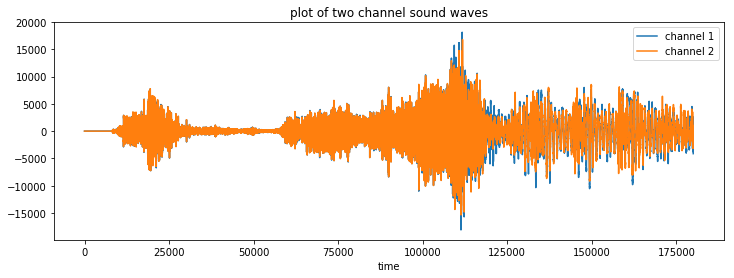

In [12]:
plt.figure(figsize=[12,4])
plt.plot(ch1[:180000],label='channel 1')
plt.plot(ch2[:180000],label='channel 2')
plt.title("plot of two channel sound waves")
plt.xlabel("time")
plt.legend()
plt.show()

now suppress the voice by subtracting ch2 from ch1

In [13]:
voice_supressed=(ch1-ch2)/2

that looks like

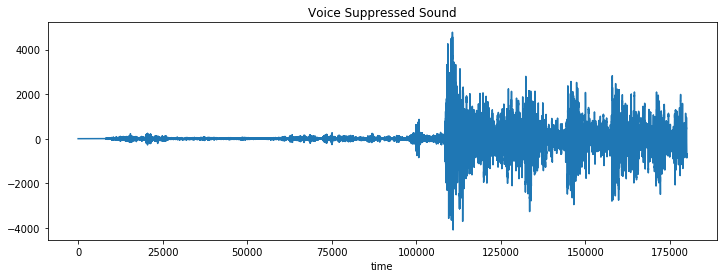

In [14]:
plt.figure(figsize=[12,4])
plt.plot(voice_supressed[:180000])
plt.title("Voice Suppressed Sound")
plt.xlabel("time")
plt.show()

now we're ready to compare the original with voice supression

#### original
Channel 1 and Channel 2 sound very similar. so wlog, we choose 1. We severely restrict the duration and begin at a point where the voice over begins.

In [15]:
Audio(wavedata[:,0][1200000:2200000],rate=datarate)

#### Voice Surpressed

In [16]:
Audio(voice_supressed[1200000:2200000],rate=datarate)

If one concentrates enough (and with a good speaker), it's possible to spot the residues of the singer's voice, but it's clear most of the voice is gone.

### Complicated Example: Frozen
Frozen's 'Let it Go' by Idina Menzel  is an example where this voice removal technique somewhat fails. We carefully choose a youtube version of the song with minimum post-processing.

In [18]:
"""
from __future__ import unicode_literals
import youtube_dl


ydl_opts = {
    'format': 'bestaudio/best',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '192',
    }],
}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=L0MK7qz13bU&ab_channel=DisneyUK'])
"""
None #don't print the string above

and load

In [19]:
datarate,wavedata=scipy.io.wavfile.read("FROZEN _ Let It Go Sing-along _ Official Disney UK-L0MK7qz13bU.wav")

it also has two channels like in Mulan's case:

In [20]:
wavedata.shape # latter is channel

(11646327, 2)

In [21]:
ch1=wavedata[:,0]
ch2=wavedata[:,1]
voice_suppressed=(ch1-ch2)/2 #suppress voice

#### Original

In [22]:
Audio(wavedata[:,0][6200000:7200000],rate=datarate)

#### Voice Suppressed

In [23]:
Audio(voice_suppressed[6200000:7200000],rate=datarate)

Voice has been suppressed, but to a much lesser extent than the mulan's case. We're not very confident, but we believe it's due to lot of sound post-processing effects of modern Disney (Frozen came out in 2013 vs 1998 of Mulan) films where effects are applied to two channels separately altogether with the voice overs. This may explain why in the voice suppressed sound, the residue of singer's voice can only be heard in the form of 'echo', which is a result of post-processing

But if the above is not the case, we can further attempt to suppress the voice using the Singer's vocal range. The singer, Idina Kim Menzel has a vocal range of C3-C6 ($130 \sim 1046 $ Hz). We can use FFT to remove sound with such frequency:

First note FFT (Cooley–Tukey algorithm) is most efficient when the data size is close to powers of 2 and we should stay away from primes at all times especially for larger numbers, so pad the data such that its length as a power of 2.

In [24]:
voice_suppressed.shape

(11646327,)

the closest power of 2 is:

In [25]:
2**24

16777216

then do FFT and filter

In [26]:
#pad and paste upto some point
voice_sup_padded=np.zeros(2**24)
voice_sup_padded[:len(voice_suppressed)]=voice_suppressed

In [27]:
#FFT
fftfreq=np.fft.fftfreq(len(voice_sup_padded),d=1/datarate)
freqdata=np.fft.fft(voice_sup_padded)

In [28]:
#filter
filterpass=(np.abs(fftfreq)<130.8) | (np.abs(fftfreq)>1046.5) #pass for sound outside the singer's vocal range
filtered_data=np.real(np.fft.ifft(filterpass*freqdata))

In [30]:
Audio(filtered_data[6200000:7200000],rate=datarate)

The quality hit on the song is quite devastating and the 'echo' of the singer's voice clearly survived (although one can claim it helped remove some of it as well). So in general this method is ill advised, unless an extra information exists that can finely subdivide the singer's vocal range so that there is no quality drop in the background sound.

## 2. Basic Sound Filters

### "Time" Varying Low Pass Filter

We start by creating a low pass filter which varies in "time" it initially does not restrict frequencies, but over time it allows lower and lower frequencies to go through. We use an example shown in class as it is good to do a demonstration with. 

In [31]:
datafilename = r'chorus-cluster2-gurnett.wav'
datarate, wavedata = scipy.io.wavfile.read(datafilename)


Audio(wavedata, rate=datarate)

This example has a lot of high frequencies (the birds chirping) and a lot of low frequencies (the noise or perhaps sound of a running river in the background).

Now, we follow the steps to create a regular low pass filter. We take the Fourier transform of the audio data.

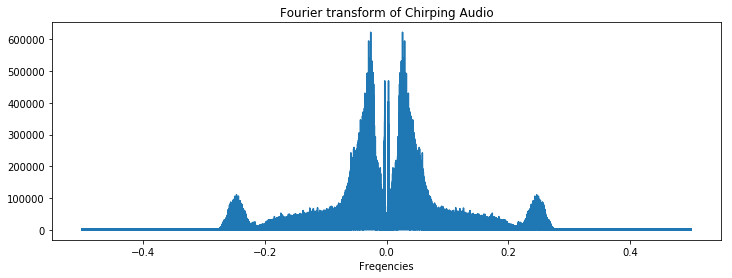

In [32]:
# Fourier transform of the audio data
freqdata = np.fft.fft(wavedata)
freqdata[0] = 0  # there is often a spike at zero frequence

# Find the frequencies
fftfreq = np.fft.fftfreq( len(wavedata) )

# Plot
plt.figure(figsize=[12,4])
plt.plot( fftfreq, np.abs(freqdata) )
plt.xlabel("Freqencies")
plt.title("Fourier transform of Chirping Audio")

plt.show()

 We create a time varying low pass filter by discretely increasing the frequencies which are allowed through. We choose to divide the above audio file into twenty segments. Every 1/20th of the audio clip, the low pass filter will increase restriction. We compare this to the original low pass filter shown in class.

Here is the original low pass filter in class.

In [33]:
# Original example of the low pass filter in lecture
lowpass = np.abs(fftfreq) < 0.05


lowdata = np.real( np.fft.fft( lowpass * freqdata ) )
lowdata /= np.max(np.abs(lowdata)) / 32767
lowdata -= np.mean(lowdata)

Audio( lowdata, rate= 44100)

Now, to create the time-varying low pass filter. We perform the same algorithm, but in a loop to increase the restriction of the low pass filter through each iteration.

In [34]:
# Divide frequencies into distinct sections. We choose to do twenty
divnum = len(fftfreq) // 20

# Create an initial array to store our values for the time varying low pass filter
tvlowdata = np.zeros(len(lowdata))

# Loop through twenty iterations
for j in range(20):
    
    # Define start and end indices for the audio file
    start = divnum*j
    end = divnum*(j+1)
    
    # Increase the low pass filter every iteration
    lowpass = np.abs(fftfreq) < 0.5-0.025*j

    lowdata = np.real( np.fft.fft( lowpass * freqdata ) )
    lowdata /= np.max(np.abs(lowdata)) / 32767
    lowdata -= np.mean(lowdata)
    
    # Now, slowly create the time varying data through each iteration   
    tvlowdata[start:end] = lowdata[start:end]

Audio(tvlowdata, rate=44100)
    

We compare the two low pass filters, the example shown in class and the time-varying low pass filter. Initially, our time-varying low pass filter allows the chirping noises to be heard. This is because those high frequencies are still being allowed through. However, by around ~50 seconds, no more chirping noises can be heard. This is because our time varying low pass filter has increased in discrete steps to allow only lower and lower frequencies. 

However, this algorithm is very inefficient and not recommended. It calculates twenty fourier transforms for the entire audio data and only uses a segment of each of them for the time-varying low pass filter. There may be other ways to create a time-varying filter in a more effective manner. 

### Gaussian Filter via Convolution

Gaussian filter, or sometimes referred to as Gaussian smooth is a process in which the signal is convolved with a finite gaussian signal. To most people who are interested in sound processing, it is quite trivial and dull, but in the programmer's perspective who's working with sound, it is an excellent example that demonstrates the power of FFT. First fetch Beetoven's song from youtube.

In [35]:
"""
from __future__ import unicode_literals
import youtube_dl


ydl_opts = {
    'format': 'bestaudio/best',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '192',
    }],
}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=k_UOuSklNL4&ab_channel=wmd10'])
"""
None # don't print the string above

load and make gaussian function.

In [36]:
datarate,wavedata=scipy.io.wavfile.read("Beethoven-Fur Elise-k_UOuSklNL4.wav")

#define gaussian with all constants =1
gaussian= lambda x: np.exp(-x**2)

This song has two channels:

In [37]:
wavedata.shape # latter is channel

(8502160, 2)

In [38]:
#separate channels
ch1=wavedata[:,0]
ch2=wavedata[:,1]

Suppose one tries to apply gaussian filter directly using convolution process. For small point spread function (kernel), this would be no problem:

In [39]:
#gaussian of size 
begin=time.time() #measure time

x=np.linspace(-1,1,400)
convolved=np.convolve(ch1,gaussian(x))

end=time.time()

print("Time taken: ",end-begin," seconds")

Time taken:  0.632448673248291  seconds


But what if we want a wider gaussian function as our kernel?

In [40]:
#gaussian of size 
begin=time.time() #measure time

x=np.linspace(-1000,1000,40000)
convolved=np.convolve(ch1,gaussian(x))

end=time.time()

print("Time taken: ",end-begin," seconds")

Time taken:  48.95636773109436  seconds


A filter that drastically changes its performance in general would not be a good filter tool (technically this problem can be solved by 'rescaling' the range of x (width and number of points of Gaussian) at some cost, but it's still undesriable).

Here is where the power of FT comes into play:

FT theorem: For signal $f$ and $g$, the convolution $f*g$ is
$$f*g=F^{-1}(F(f)\cdot F(g))$$

where by convention, $F$ denotes fourier transform and $*$ denotes convolution of functions $f$ and $g$.

Now apply this formula.  
Again, pad data until it's a power of 2 for FFT efficiency.

In [41]:
ch1.shape

(8502160,)

The cloests power of 2 to this prime is

In [42]:
2**24

16777216

In [43]:
#pad wavedata
wave_padded=np.zeros(2**24)
wave_padded[:len(wavedata)]=ch1

# x values for gaussian
x=np.linspace(-1000,1000,40000)

# pad kernel as well since we need to multiply it with wave_padded
kernel_padded=np.zeros(len(wave_padded))
kernel_padded[len(wave_padded)//2 : len(wave_padded)//2+len(x)]=gaussian(x)

In [44]:
#fft data and kernel

begin=time.time() #measure time

fftdata=np.fft.fft(wave_padded)
fftkernel=np.fft.fft(kernel_padded)

end=time.time()

print("Time taken: ",end-begin," seconds")

Time taken:  2.902055025100708  seconds


In [45]:
#inverse FFT. get filtered result

begin=time.time() #measure time

g_filtered=np.real(np.fft.ifft(fftdata*fftkernel))

end=time.time()

print("Time taken: ",end-begin," seconds")

Time taken:  1.9403905868530273  seconds


#### original

In [46]:
Audio(ch1[:450000],rate=datarate)

#### gaussian filtered

In [47]:
Audio(g_filtered[len(g_filtered)//2:len(g_filtered)//2+450000],rate=datarate) # begin at half since it was padded

Thus we succesfully created an efficinet gaussian filter (~4 seconds vs ~30 seconds ). If we increase the length of kernel (gaussian), if one uses the regular convolution, the computation time will increase exponentially. But if one uses FFT, time will increase as N logN, made possible by FT Theorem. It's obvious which one is the preferred one.

## Convolution Reverb

Another way in which convolutions can be applied to audio is with convolution reverb. This effect uses convolution of two different sounds. It requires one of the sounds to be an "impulse response" this is a loud sound that causes reverbertation in an acoustic environment. The impulse response in a way "maps" out the properties of that acoustic environment. Then, if we convole the impulse response with another another sound (the target sound), then the resulting output will be as if the target sound was played in the acoustic environment of the impulse response. For more information, visit: https://music.tutsplus.com/tutorials/how-to-use-convolution-for-reverb-effects--audio-1089

Let us show an example. Our impulse response will be the sound of a gunshot. This sound is very short and very loud.

In [48]:
datafilename = r'180961__kleeb__gunshots.wav'
datarate, wavedata = scipy.io.wavfile.read(datafilename)

impulselength = len(wavedata[:,0])

Audio(wavedata[:,0], rate=datarate) #Looking at channel 1 of the wave data, as the wav file is stereo. 


We plot the sound profile of the gunshot. As expected, the sound profile has initially high magnitude burst that "echoes" or reverberates off of the environment.

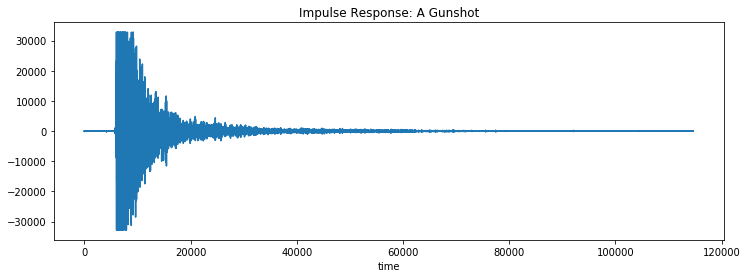

In [49]:
plt.figure(figsize=[12,4])
plt.plot(wavedata[:,0])
plt.title("Impulse Response: A Gunshot")
plt.xlabel("time")

plt.show()


Next, we choose our target sound which the reverberate effect will be applied too. We choose a group of people talking from the freesounds database.

In [50]:
talkfilename = r'222993__zyrytsounds__people-talking.wav'
talkDrate, talkWdata = scipy.io.wavfile.read(talkfilename)

# We choose one channel as the .wav file is stereo
monotalkWdata = talkWdata[:,0]

# We look at the wave data for the same amount of time as the impulse response, impulselength to 2*impulse length

Audio(monotalkWdata[impulselength:2*impulselength], rate = talkDrate)

And again, we plot the audio profile for our target sound.

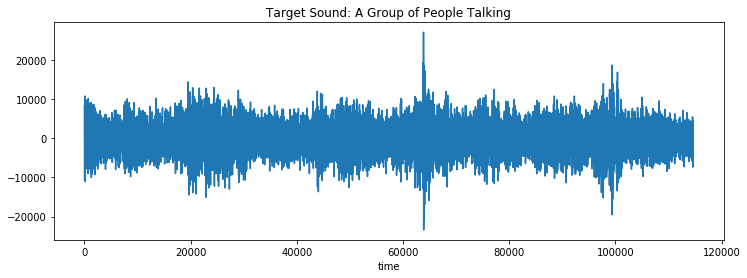

In [51]:
plt.figure(figsize=[12,4])
plt.plot(monotalkWdata[impulselength:2*impulselength])
plt.title("Target Sound: A Group of People Talking")
plt.xlabel("time")

plt.show()

Again, using the convolution theory. We take the fourier transform of each of these audio files, multiple them together, and take the inverse fourier transform. We do not worry about computing an efficient FFT for this case as the audio files are so small.

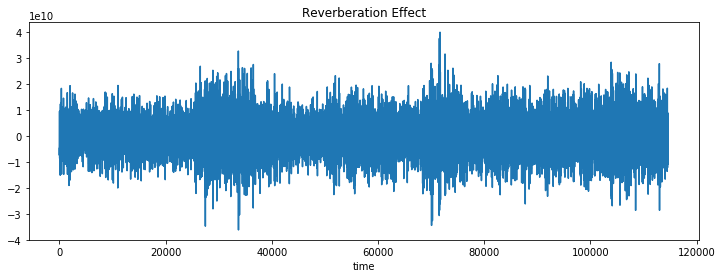

In [52]:
# FFT of impulse and target response
wavefft = np.fft.fft(wavedata[:,0])
talkfft = np.fft.fft(monotalkWdata[impulselength:2*impulselength])

# We take only the real portion as the fft results in complex numbers which we cannot read using the audio command.
convolved = np.real(np.fft.ifft(wavefft * talkfft))

# Plot the convolved talk
plt.figure(figsize=[12,4])
plt.plot(convolved)
plt.title("Reverberation Effect")
plt.xlabel("time")
plt.show()

Now, let us hear the result. Which should sound as if the target sound (people talking) was being played in the acoustic environment of the impulse response (gunshot).


In [53]:
Audio(convolved, rate=talkDrate)

The resulting audio does sound as if this is the case. It sounds as if the group of people are talking in a shooting range (acoustic environment of the gunshot). However, it could be worthwhile to test the reverberation effects with other target sounds. The reverberate effect is only as good as the impulse response, so other short bursts of sound in different acoustic environments could be tested to see what effects can be made. 

# Conclusion

In this notebook, we explored a few ways to use Fourier transforms to manipulate audio in an interesting way. We tried to talk the vocals out of famous disney songs, created two filters, and played around with reverbertation effects. However, there are many possibilities with the use of Fourier transforms in audio settings. For instance, the app Shazam! can record and identify songs through the use of Fourier transforms. 